In [ ]:
%tensorflow_version 1.x
import tensorflow as tf

%cd /content/
!git clone https://github.com/pbaylies/stylegan2-ada
%cd /content/stylegan2-ada

TensorFlow 1.x selected.
/content
Cloning into 'stylegan2-ada'...
remote: Enumerating objects: 361, done.
remote: Total 361 (delta 0), reused 0 (delta 0), pack-reused 361
Receiving objects: 100% (361/361), 61.57 MiB | 37.96 MiB/s, done.
Resolving deltas: 100% (197/197), done.
/content/stylegan2-ada


In [ ]:
!wget https://archive.org/download/wikiart-stylegan2-conditional-model/WikiArt5.pkl

--2021-02-11 04:48:36--  https://archive.org/download/wikiart-stylegan2-conditional-model/WikiArt5.pkl
Resolving archive.org (archive.org)... 207.241.224.2
Connecting to archive.org (archive.org)|207.241.224.2|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://ia902803.us.archive.org/30/items/wikiart-stylegan2-conditional-model/WikiArt5.pkl [following]
--2021-02-11 04:48:36--  https://ia902803.us.archive.org/30/items/wikiart-stylegan2-conditional-model/WikiArt5.pkl
Resolving ia902803.us.archive.org (ia902803.us.archive.org)... 207.241.232.103
Connecting to ia902803.us.archive.org (ia902803.us.archive.org)|207.241.232.103|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 385793980 (368M) [application/octet-stream]
Saving to: ‘WikiArt5.pkl’

WikiArt5.pkl        100%[===================>] 367.92M   629KB/s    in 7m 39s  

2021-02-11 04:56:16 (820 KB/s) - ‘WikiArt5.pkl’ saved [385793980/385793980]



In [ ]:
%cd /content/stylegan2-ada

/content/stylegan2-ada


In [ ]:
import pickle
import dnnlib
import dnnlib.tflib as tflib

network_pkl = '/content/stylegan2-ada/WikiArt5.pkl'
dnnlib.tflib.init_tf()
with dnnlib.util.open_url(network_pkl) as f:
    _G, _D, Gs = pickle.load(f)

Gs_kwargs = dnnlib.EasyDict()
Gs_kwargs.output_transform = dict(func = tflib.convert_images_to_uint8, nchw_to_nhwc = True)
Gs_kwargs.randomize_noise = False

In [ ]:
import numpy as np

def generate_zs_from_seeds(seeds):
  zs = []
  for seed_idx, seed in enumerate(seeds):
    rnd = np.random.RandomState(seed)
    z = rnd.randn(1, *Gs.input_shape[1:])
    zs.append(z)
  return zs

In [ ]:
!pip install tqdm

In [ ]:
def generate_images_w_settings(zs, variance, iterations, scale, truncation):
  imgs = []

  for z_idx, z in tqdm(enumerate(zs)):
    batch_size = 1
    l1 = np.zeros((1,167))
    l1 = scale * l1
    all_z = z
    all_w = Gs.components.mapping.run(all_z, l1) # [minibatch, layer, component]
    if truncation != 1:
        w_avg = Gs.get_var('dlatent_avg')
        all_w = w_avg + (all_w - w_avg) * truncation # [minibatch, layer, component]
    if variance == 0 or iterations < 1:
        all_images = Gs.components.synthesis.run(all_w, **Gs_kwargs)
        imgs.append(PIL.Image.fromarray(all_images[0], 'RGB'))
    else:
        acc_w = np.zeros((batch_size,18,512))
        total = 0.0
        for i in range(iterations):
            all_w = Gs.components.mapping.run(all_z + variance*np.random.RandomState(i).randn(512), np.tile(l1 + variance*np.random.RandomState(i).randn(167), (batch_size, 1))) # [minibatch, layer, component]
            if truncation != 1:
                w_avg = Gs.get_var('dlatent_avg')
                all_w = w_avg + (all_w - w_avg) * truncation # [minibatch, layer, component]
            acc_w += all_w
            total+=1.0
        acc_w /= total
        all_images = Gs.components.synthesis.run(acc_w, **Gs_kwargs)
        imgs.append(PIL.Image.fromarray(all_images[0], 'RGB'))

  return imgs


In [153]:
seeds = np.random.randint(10000000, size=9)
print(seeds)

zs = generate_zs_from_seeds(seeds)
# modify variance, iterations, and truncation to change the output (the scale parameter doesn't seem to do much, I'm not sure what it's supposed to be for)
imgs1 = generate_images_w_settings(zs, .5, 64, 2, .6) # default
imgs2 = generate_images_w_settings(zs, .1, 64, 2, 1.5) # low variance, high truncation
imgs3 = generate_images_w_settings(zs, 0.8, 64, 2, 1.5) # high variance, high truncation
imgs4 = generate_images_w_settings(zs, 0.1, 64, 2, .3) # low variance, low truncation
imgs5 = generate_images_w_settings(zs, 0.8, 64, 2, .3) # high variance, low truncation

0it [00:00, ?it/s]

[8584291 1889708 4498121 4555296 6593213 7877285 2628770 3409161 1147847]


9it [00:02,  4.48it/s]
9it [00:01,  4.55it/s]
9it [00:01,  4.57it/s]
9it [00:01,  4.53it/s]
9it [00:01,  4.71it/s]


In [ ]:
from math import ceil

def createImageGrid(image_arr, scale=0.25, rows=1):
  canvases = []

  # create image grids from each set
  for images in image_arr: 
    w,h = images[0].size
    w = int(w*scale)
    h = int(h*scale)
    height = rows*h
    cols = ceil(len(images) / rows)
    width = cols*w
    canvas = PIL.Image.new('RGBA', (width,height), 'white')
    for i,img in enumerate(images):
      img = img.resize((w,h), PIL.Image.ANTIALIAS)
      canvas.paste(img, (w*(i%cols), h*(i // cols)))
    canvases.append(canvas)
 
 # append all image sets into one large image
  total_width, h = canvases[0].size
  total_height = len(image_arr)*h + 20
  all_canvases = PIL.Image.new('RGBA', (total_width, total_height), 'white')
  y = 0
  for i,canvas in enumerate(canvases):
    all_canvases.paste(canvas, (total_width*(i%1), y))
    y += h + 5
  return all_canvases

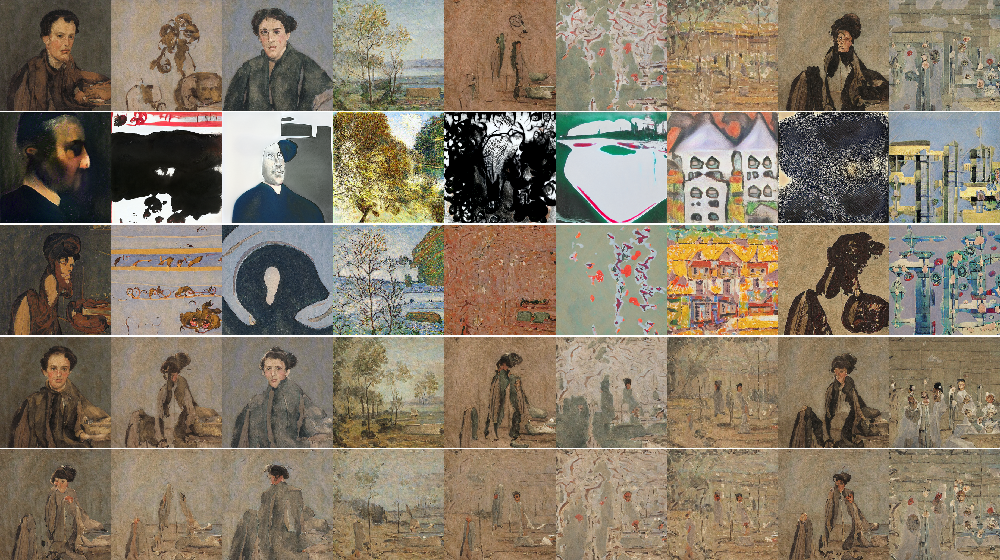

In [154]:
createImageGrid([imgs1,imgs2,imgs3,imgs4,imgs5])